In [1]:
!pip install pandas
!pip install matplotlib
!pip install seaborn
!pip install numpy
!pip install scipy
!pip install scikit-learn
!pip install kagglehub

In [2]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from scipy.cluster.hierarchy import dendrogram, linkage
from scipy.spatial.distance import pdist
import numpy as np
from typing import Any

from numpy import signedinteger


In [3]:
np.random.seed(0)

In [4]:
import kagglehub

# Download latest version
path = kagglehub.dataset_download("harrywang/wine-dataset-for-clustering")
df = pd.read_csv(f'{path}/wine-clustering.csv')

In [5]:
X = df.iloc[:, :]

X

,Alcohol,Malic_Acid,Ash,Ash_Alcanity,Magnesium,Total_Phenols,Flavanoids,Nonflavanoid_Phenols,Proanthocyanins,Color_Intensity,Hue,OD280,Proline
0,14.23,1.71,2.43,15.6,127,2.80,3.06,0.28,2.29,5.64,1.04,3.92,1065
1,13.20,1.78,2.14,11.2,100,2.65,2.76,0.26,1.28,4.38,1.05,3.40,1050
2,13.16,2.36,2.67,18.6,101,2.80,3.24,0.30,2.81,5.68,1.03,3.17,1185
3,14.37,1.95,2.50,16.8,113,3.85,3.49,0.24,2.18,7.80,0.86,3.45,1480
4,13.24,2.59,2.87,21.0,118,2.80,2.69,0.39,1.82,4.32,1.04,2.93,735
...,...,...,...,...,...,...,...,...,...,...,...,...,...
173,13.71,5.65,2.45,20.5,95,1.68,0.61,0.52,1.06,7.70,0.64,1.74,740
174,13.40,3.91,2.48,23.0,102,1.80,0.75,0.43,1.41,7.30,0.70,1.56,750
175,13.27,4.28,2.26,20.0,120,1.59,0.69,0.43,1.35,10.20,0.59,1.56,835
176,13.17,2.59,2.37,20.0,120,1.65,0.68,0.53,1.46,9.30,0.60,1.62,840


In [6]:
from sklearn.manifold import TSNE


def plot_tsne_comparison(X: np.ndarray, cluster_y: np.ndarray, library_cluster_y: np.ndarray):
    tsne = TSNE(
        n_components=2,
        random_state=0,
        perplexity=20.0,
        metric='euclidean',
    )
    tsne_results = tsne.fit_transform(X)

    tsne_df = pd.DataFrame(tsne_results, columns=['TSNE1', 'TSNE2'])

    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 6))

    ax1.scatter(tsne_df['TSNE1'], tsne_df['TSNE2'], c=library_cluster_y, cmap='viridis')

    ax1.set_title('Библиотечная реализация')
    ax1.set_xlabel('TSNE1')
    ax1.set_ylabel('TSNE2')

    ax2.scatter(tsne_df['TSNE1'], tsne_df['TSNE2'], c=cluster_y, cmap='viridis')
    ax2.set_title('Моя реализация')
    ax2.set_xlabel('TSNE1')
    ax2.set_ylabel('TSNE2')

    # plt.legend(bbox_to_anchor=(1, 1), loc='upper left')
    plt.tight_layout()
    plt.show()

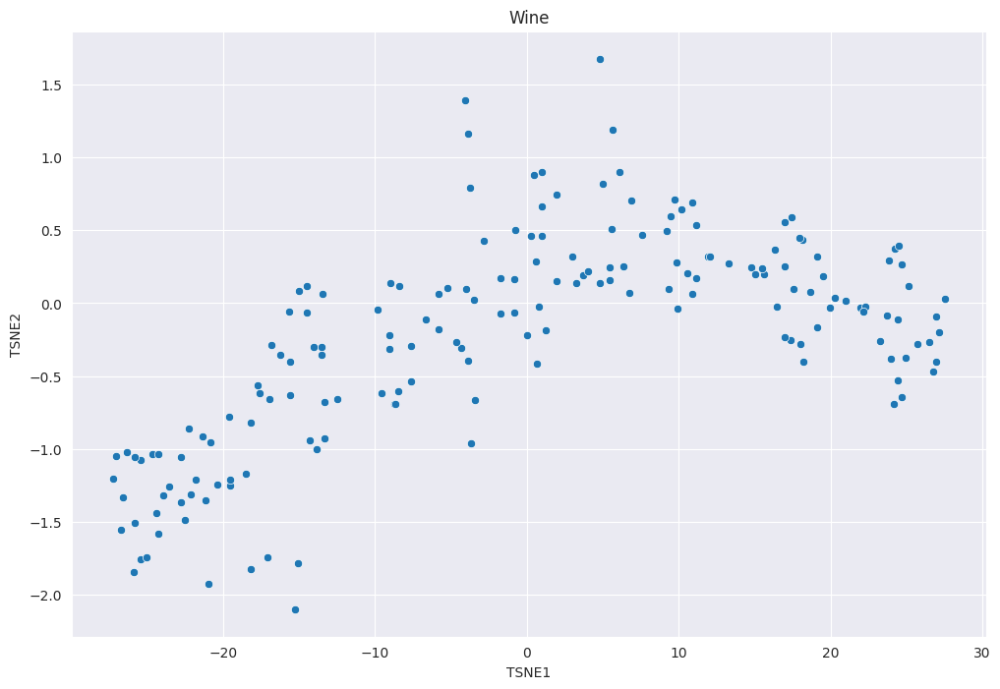

In [68]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.manifold import TSNE

X = X.apply(pd.to_numeric, errors='coerce')

X = X.dropna()

tsne = TSNE(
    n_components=2,
    random_state=0,
    perplexity=20.0,
    metric='euclidean',
)
tsne_results = tsne.fit_transform(X)

tsne_df = pd.DataFrame(tsne_results, columns=['TSNE1', 'TSNE2'])
# tsne_df['species'] = df['species']

plt.figure(figsize=(12, 8))
sns.scatterplot(x='TSNE1', y='TSNE2',
                # hue='species',
                data=tsne_df,
                # palette='tab10'
                )
plt.title('Wine')
plt.xlabel('TSNE1')
plt.ylabel('TSNE2')
# plt.legend(bbox_to_anchor=(1, 1), loc='upper left')
plt.show()

# HIERARCHICAL CLUSTERING

In [77]:
import itertools
from enum import IntEnum


def make_condensed_distance_matrix_index(m: int):
    def resolve_index(i: int, j: int) -> int:
        if i == j:
            raise ValueError("`i` must be less `j`")
        i, j = sorted((i, j))
        return m * i + j - (i + 2) * (i + 1) // 2

    return resolve_index


def pairwise_distance(X: np.ndarray) -> np.ndarray:
    sample_size = X.shape[0]
    pairs = np.array(list(itertools.combinations(range(sample_size), 2)))
    differences = X[pairs[:, 0]] - X[pairs[:, 1]]
    distances = np.linalg.norm(differences, axis=1)
    return distances


class LinkageTableIndex(IntEnum):
    DISTANCE = 2
    CLUSTER_SIZE = 3


def link(
        distances_matrix: np.ndarray
) -> np.ndarray:
    samples_count = int((1 + 8 * len(distances_matrix)) ** 0.5 + 1) // 2
    cluster_index_map = [i if i < samples_count else None for i in range(samples_count * 2 - 1)]
    resolve = make_condensed_distance_matrix_index(samples_count)
    c = set(range(samples_count))
    sigma, sigma_step = 0.0, 0.1
    table: list[list] = []

    for new_cluster_number in np.arange(samples_count, samples_count * 2 - 1):
        while not (p := [
            (i, j) for i, j in itertools.combinations(c, 2)
            if
            cluster_index_map[i] is not None and
            cluster_index_map[j] is not None and
            distances_matrix[
                resolve(cluster_index_map[i], cluster_index_map[j])
            ] <= sigma
        ]) and len(
            c) > 1:
            sigma += sigma_step

        if not p:
            return np.array(table)

        new_cluster = min(
            p,
            key=lambda cluster_pair_indexes:
            distances_matrix[
                resolve(
                    cluster_index_map[cluster_pair_indexes[0]],
                    cluster_index_map[cluster_pair_indexes[1]]
                )
            ]
        )
        v, u = sorted(new_cluster)
        r_u_v = distances_matrix[resolve(cluster_index_map[v], cluster_index_map[u])]
        if v < samples_count:
            power_v = 1
        else:
            power_v = table[v - samples_count][LinkageTableIndex.CLUSTER_SIZE]
        if u < samples_count:
            power_u = 1
        else:
            power_u = table[u - samples_count][LinkageTableIndex.CLUSTER_SIZE]
        power_u_v = power_v + power_u
        table.append([v, u, r_u_v, power_u_v])
        dead_cluster = cluster_index_map[v]

        for i, s in enumerate(cluster_index_map):
            if s is None or i in [v, u]:
                continue
            power_s = 1 if i < samples_count else table[i - samples_count][3]
            r_u_s = distances_matrix[resolve(cluster_index_map[u], cluster_index_map[i])]
            r_v_s = distances_matrix[resolve(cluster_index_map[v], cluster_index_map[i])]
            alpha_u = (power_s + power_u) / (power_s + power_u_v)
            alpha_v = (power_s + power_v) / (power_s + power_u_v)
            beta = -power_s / (power_s + power_u_v)
            r_u_v_s = r_u_s ** 2 * alpha_u + r_v_s ** 2 * alpha_v + r_u_v ** 2 * beta
            distances_matrix[resolve(dead_cluster, cluster_index_map[i])] = r_u_v_s ** 0.5

        c -= {v, u}
        c.add(new_cluster_number)
        cluster_index_map[v] = cluster_index_map[u] = None
        cluster_index_map[new_cluster_number] = dead_cluster

    return np.array(table)


def find_threshold_cluster(link_table: np.ndarray) -> signedinteger[Any]:
    return np.argmax(np.diff(link_table[:, 2]))


distances = pairwise_distance(X.to_numpy())
link_table = link(
    distances_matrix=distances,
)

link_table = np.array(link_table, dtype=np.float64)
link_table

array([[1.60000000e+02, 1.65000000e+02, 2.61070872e+00, 2.00000000e+00],
       [6.70000000e+01, 1.06000000e+02, 2.65471279e+00, 2.00000000e+00],
       [1.30000000e+01, 5.00000000e+01, 2.94961014e+00, 2.00000000e+00],
       [8.00000000e+00, 9.00000000e+00, 3.27007645e+00, 2.00000000e+00],
       [1.01000000e+02, 1.19000000e+02, 3.47925279e+00, 2.00000000e+00],
       [1.68000000e+02, 1.74000000e+02, 3.88500965e+00, 2.00000000e+00],
       [6.10000000e+01, 8.50000000e+01, 4.00372327e+00, 2.00000000e+00],
       [1.23000000e+02, 1.25000000e+02, 4.46960848e+00, 2.00000000e+00],
       [1.24000000e+02, 1.85000000e+02, 4.60571384e+00, 3.00000000e+00],
       [8.60000000e+01, 1.16000000e+02, 4.67362814e+00, 2.00000000e+00],
       [4.30000000e+01, 6.00000000e+01, 4.78464210e+00, 2.00000000e+00],
       [1.32000000e+02, 1.77000000e+02, 4.78493469e+00, 2.00000000e+00],
       [1.05000000e+02, 1.08000000e+02, 4.98254955e+00, 2.00000000e+00],
       [2.20000000e+01, 2.90000000e+01, 5.18481437e

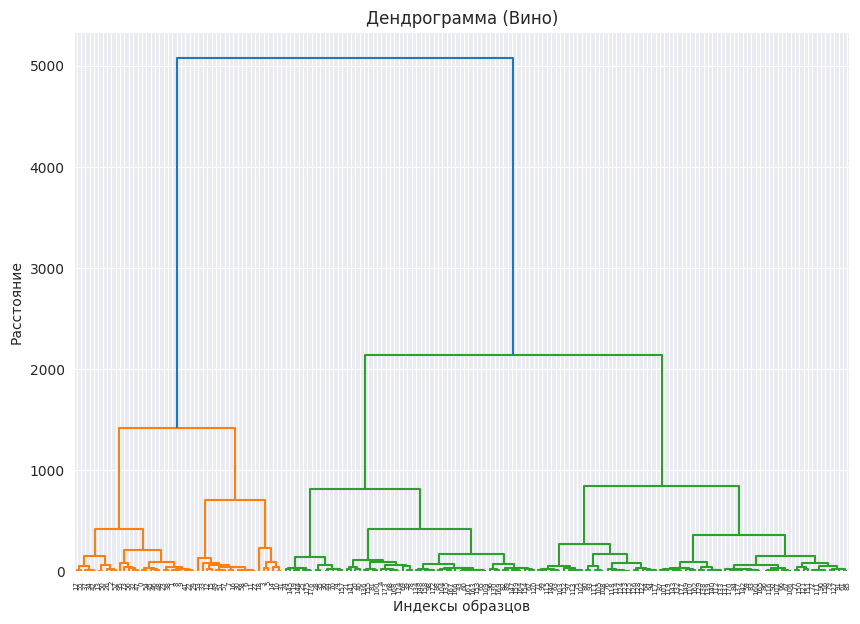

In [78]:
plt.figure(figsize=(10, 7))
dendrogram(link_table)
plt.title('Дендрограмма (Вино)')
plt.xlabel('Индексы образцов')
plt.ylabel('Расстояние')
plt.show()

In [9]:
threshold_cluster = find_threshold_cluster(link_table)
threshold_cluster

np.int64(175)

In [10]:
def allocate_clusters(
        samples: np.ndarray[np.float32],
        link_table: np.ndarray,
        threshold_cluster: int,
) -> np.ndarray:
    clusters = {i: {i} for i in range(len(samples))}

    for cluster, (i, j, distance, size) in enumerate(link_table, start=len(samples)):
        clusters[cluster] = clusters.pop(i) | clusters.pop(j)
        if cluster == len(samples) + threshold_cluster:
            break
        # if distance <= threshold:
        #     clusters[cluster] = clusters.pop(i) | clusters.pop(j)

    cluster_labels = [(sample, cluster) for cluster, samples in clusters.items() for sample in samples]
    sorted_cluster_labels = np.array(sorted(cluster_labels, key=lambda record: record[0]))
    return np.unique(sorted_cluster_labels[:, 1], return_inverse=True)[1]


hierarchical_cluster_y = allocate_clusters(X, link_table, threshold_cluster)
hierarchical_cluster_y

array([0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1,
       0, 0, 1, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 1, 1, 0, 0, 1,
       1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1])

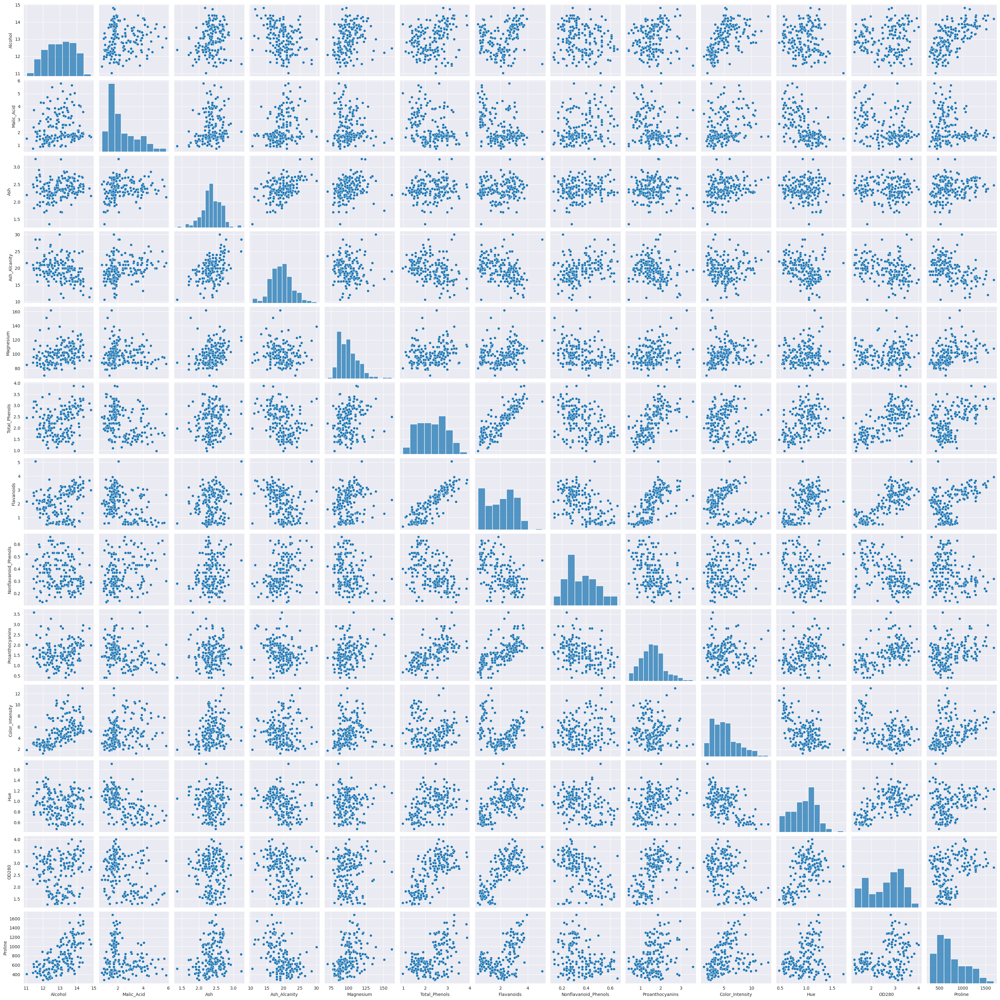

In [71]:
sns.pairplot(
    X
)

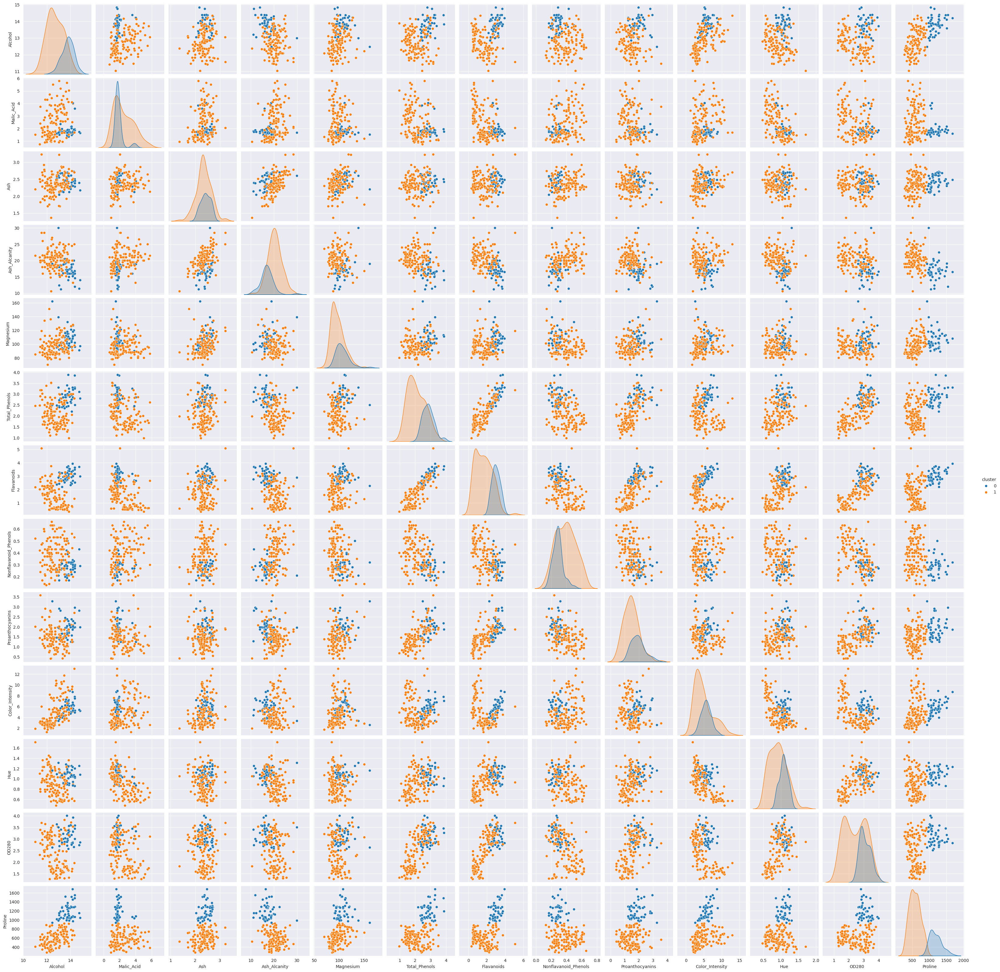

In [11]:
sns.pairplot(
    pd.concat((X, pd.DataFrame(hierarchical_cluster_y, columns=['cluster'])), axis=1),
    hue='cluster',
)

In [12]:
from scipy.cluster.hierarchy import linkage
from scipy.spatial.distance import pdist

distance_matrix = pdist(X.to_numpy(), metric='euclidean')
library_link_table = linkage(distance_matrix, method="ward")
library_link_table

array([[1.60000000e+02, 1.65000000e+02, 2.61070872e+00, 2.00000000e+00],
       [6.70000000e+01, 1.06000000e+02, 2.65471279e+00, 2.00000000e+00],
       [1.30000000e+01, 5.00000000e+01, 2.94961014e+00, 2.00000000e+00],
       [8.00000000e+00, 9.00000000e+00, 3.27007645e+00, 2.00000000e+00],
       [1.01000000e+02, 1.19000000e+02, 3.47925279e+00, 2.00000000e+00],
       [1.68000000e+02, 1.74000000e+02, 3.88500965e+00, 2.00000000e+00],
       [6.10000000e+01, 8.50000000e+01, 4.00372327e+00, 2.00000000e+00],
       [1.23000000e+02, 1.25000000e+02, 4.46960848e+00, 2.00000000e+00],
       [1.24000000e+02, 1.85000000e+02, 4.60571384e+00, 3.00000000e+00],
       [8.60000000e+01, 1.16000000e+02, 4.67362814e+00, 2.00000000e+00],
       [4.30000000e+01, 6.00000000e+01, 4.78464210e+00, 2.00000000e+00],
       [1.32000000e+02, 1.77000000e+02, 4.78493469e+00, 2.00000000e+00],
       [1.05000000e+02, 1.08000000e+02, 4.98254955e+00, 2.00000000e+00],
       [2.20000000e+01, 2.90000000e+01, 5.18481437e

In [13]:
library_hierarchical_cluster_y = allocate_clusters(X, library_link_table, threshold_cluster)
library_hierarchical_cluster_y

array([0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1,
       0, 0, 1, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 1, 1, 0, 0, 1,
       1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1])

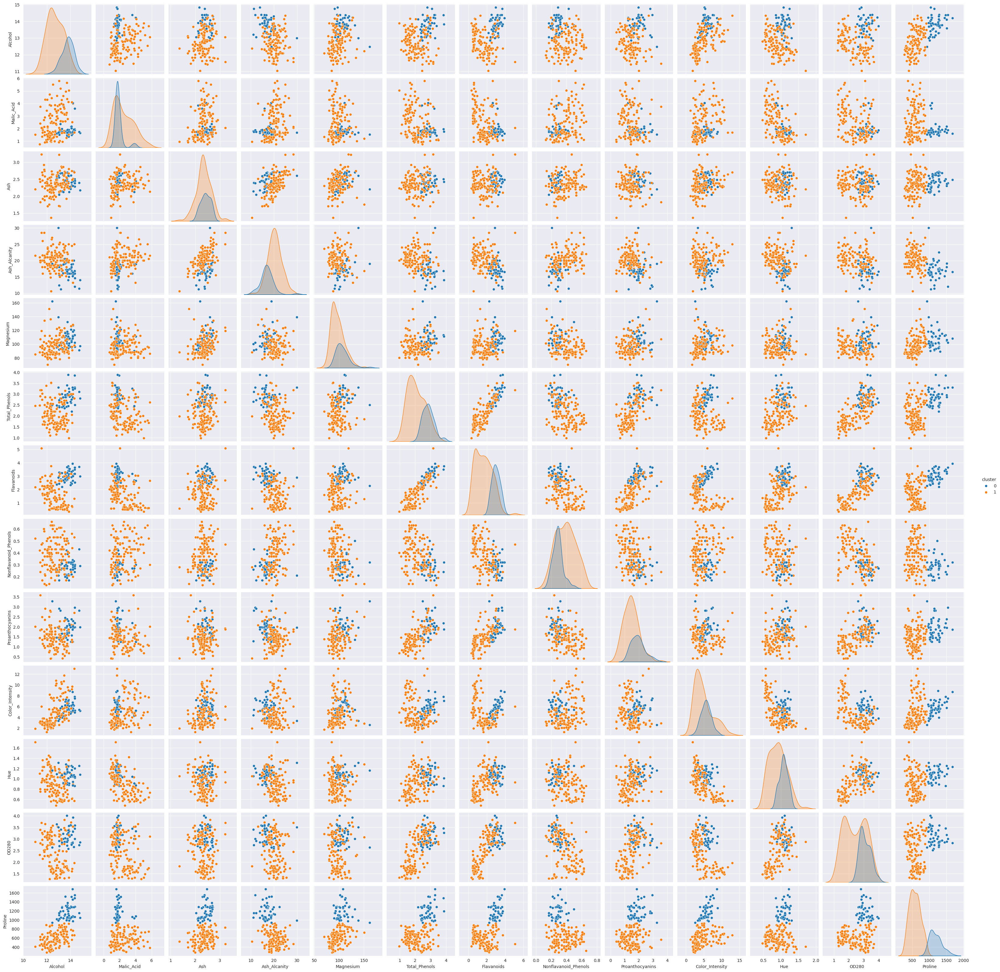

In [14]:
sns.pairplot(
    pd.concat((X, pd.DataFrame(library_hierarchical_cluster_y, columns=['cluster'])), axis=1),
    hue='cluster',
)

In [15]:
np.all(hierarchical_cluster_y == library_hierarchical_cluster_y)

np.True_

In [16]:
%timeit linkage(distance_matrix, method="ward")

190 μs ± 2.42 μs per loop (mean ± std. dev. of 7 runs, 10,000 loops each)


In [17]:
%timeit link(distances_matrix=distance_matrix)

1.56 s ± 88 ms per loop (mean ± std. dev. of 7 runs, 1 loop each)


EM ALGORITHM CLUSTERING

In [18]:
import numpy as np
from typing import Tuple

np.random.seed(0)


def init_cluster_centers_by_kmeans(samples: np.ndarray, cluster_count: int, ) -> np.ndarray:
    init_indices = np.random.choice(samples.shape[0], size=cluster_count, replace=False)
    centers = samples[init_indices]

    cluster_assignments = np.zeros(len(samples), dtype=int)
    for i, sample in enumerate(samples):
        distances = np.linalg.norm(sample - centers, axis=1) ** 2
        cluster_assignments[i] = np.argmin(distances)

    while True:
        new_centers = np.zeros_like(centers, dtype=np.float64)
        counts = np.zeros(cluster_count, dtype=np.float64)

        for i, cluster_idx in enumerate(cluster_assignments):
            new_centers[cluster_idx] += samples[i]
            counts[cluster_idx] += 1

        for j in range(cluster_count):
            if counts[j] > 0:
                new_centers[j] /= counts[j]

        if np.all(np.linalg.norm(centers - new_centers, axis=1) < 0.01):
            return new_centers

        for i, sample in enumerate(samples):
            distances = np.linalg.norm(sample - new_centers, axis=1) ** 2
            cluster_assignments[i] = np.argmin(distances)

        centers = new_centers


def p(
        X: np.ndarray,
        mean: np.ndarray,
        variance: np.ndarray
) -> np.ndarray:
    coeff = 1 / np.sqrt((2 * np.pi) ** X.shape[1] * np.prod(variance))
    exponent = -0.5 * np.sum(((X - mean) ** 2) / variance, axis=1)
    return coeff * np.exp(exponent)


def em_gmm(
        X: np.ndarray,
        cluster_count: int,
        max_iteration: int = 100,
) -> Tuple[np.ndarray, np.ndarray, np.ndarray, np.ndarray]:
    n_samples, n_features = X.shape

    # centers = X[np.random.choice(n_samples, cluster_count, replace=False)]
    # kmeans = KMeans(n_clusters=cluster_count).fit(X)
    # centers = kmeans.cluster_centers_
    centers = init_cluster_centers_by_kmeans(X, cluster_count)
    sigma = np.full((cluster_count, n_features), np.var(X, axis=0))
    w = np.full(cluster_count, 1 / cluster_count)

    centers_old = np.zeros(centers.shape)
    g = np.zeros((n_samples, cluster_count))

    for iteration in range(max_iteration):
        # E-шаг:

        g = np.array([w[k] * p(X, centers[k], sigma[k]) for k in range(cluster_count)]).T
        g = g / np.sum(g, axis=1)[:, np.newaxis]

        # M-шаг
        w = np.sum(g, axis=0)

        centers = (g.T @ X) / w[:, np.newaxis]

        for k in range(cluster_count):
            sigma[k] = np.sum(g[:, k][:, np.newaxis] * (X - centers[k]) ** 2, axis=0) / w[k]

        w = w / n_samples

        if np.all(np.abs(np.linalg.norm(centers - centers_old, axis=1)) < 1e-6):
            break
        centers_old = centers
    return np.argmax(g, axis=1)


em_cluster_y = em_gmm(X.to_numpy(), cluster_count=2, )

em_cluster_y

array([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 0, 1, 1,
       0, 1, 1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1])

In [19]:
from sklearn.mixture import GaussianMixture

gmm = GaussianMixture(n_components=2, random_state=0, max_iter=100, covariance_type='diag')
gmm.fit(X)
library_em_cluster_y = gmm.predict(X)
library_em_cluster_y

array([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 0, 0,
       1, 0, 0, 0, 0, 1, 0, 1, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0])

In [20]:
%timeit em_gmm(X.to_numpy(), cluster_count=2, )


11.4 ms ± 1.13 ms per loop (mean ± std. dev. of 7 runs, 100 loops each)


In [21]:
%timeit gmm.predict(X)


338 μs ± 969 ns per loop (mean ± std. dev. of 7 runs, 1,000 loops each)


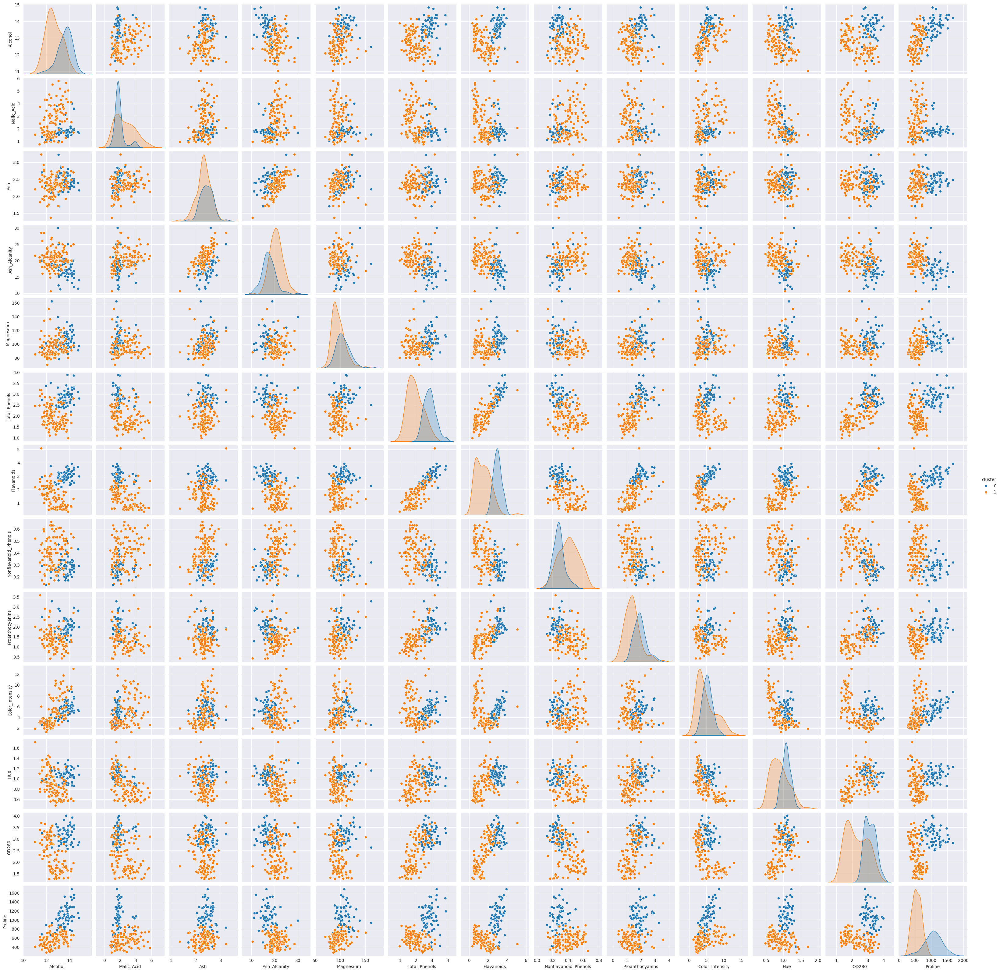

In [22]:
sns.pairplot(
    pd.concat((X, pd.DataFrame(em_cluster_y, columns=['cluster'])), axis=1),
    hue='cluster',
)

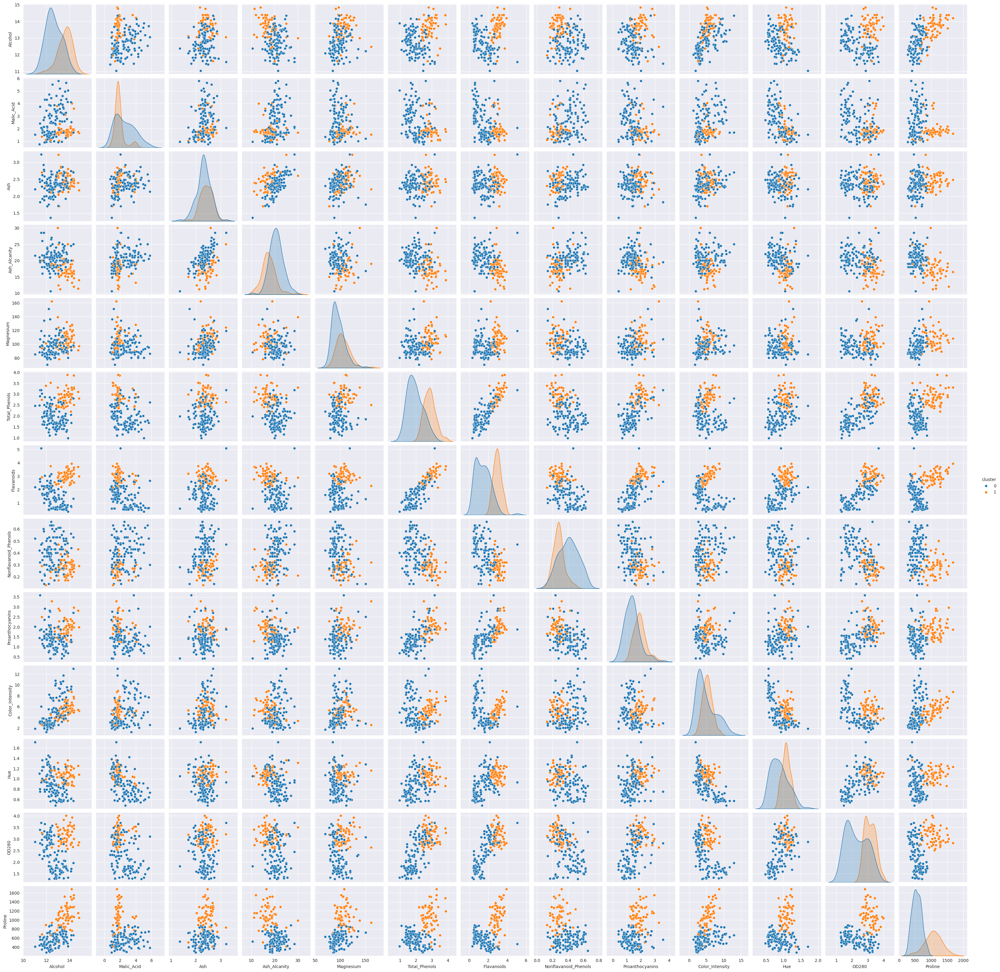

In [23]:
sns.pairplot(
    pd.concat((X, pd.DataFrame(library_em_cluster_y, columns=['cluster'])), axis=1),
    hue='cluster',
)

In [24]:
def extract_locality(X: np.ndarray, x: np.ndarray, e: float, ) -> np.ndarray:
    return np.nonzero(np.linalg.norm(X - x, axis=1) < e)[0]


def cluster_by_dbscan(X: np.ndarray, m: int, e: float) -> np.ndarray:
    l = len(X)

    labels = np.zeros(shape=(l,), dtype=np.int8)
    a = np.zeros(shape=(l,), dtype=np.int8)
    a_current = 0

    UNLABELED, NOISE, BORDER, CORE = 0, 1, 2, 3
    while np.any(unlabeled_points := np.nonzero(labels == 0)[0]):
        x_idx = np.random.choice(unlabeled_points)
        x = X[x_idx]
        locality_idx = extract_locality(X, x, e)
        if len(locality_idx) < m:
            labels[x_idx] = NOISE
        else:
            k = set(locality_idx)
            a_current = a_current + 1
            processed_points = {x_i for x_i in k if labels[x_i] in (UNLABELED, NOISE)}

            while processed_points:
                x_streak_idx = next(iter(processed_points))

                sub_locality_idx = extract_locality(X, X[x_streak_idx], e)
                if len(sub_locality_idx) >= m:
                    labels[x_streak_idx] = CORE
                    k |= set(sub_locality_idx)
                    processed_points |= {x_i for x_i in sub_locality_idx if labels[x_i] in (UNLABELED, NOISE)}
                else:
                    labels[x_streak_idx] = BORDER
                processed_points.remove(x_streak_idx)
            for x_i in k:
                a[x_i] = a_current

    return a - 1


# em_cluster_y = cluster_by_dbscan(X.to_numpy())
dbscan_cluster_y = cluster_by_dbscan(X.to_numpy(), m=10, e=30)
dbscan_cluster_y

array([ 2,  2, -1, -1, -1, -1,  1,  1,  2,  2, -1,  1, -1, -1, -1,  1,  1,
       -1, -1, -1, -1, -1,  2, -1, -1, -1, -1,  1, -1,  2,  1, -1, -1, -1,
       -1, -1, -1, -1,  2, -1, -1,  2, -1,  0, -1,  2,  2, -1,  2,  1, -1,
        1, -1, -1,  2, -1, -1,  1,  1,  0,  0,  0,  0,  0,  0,  0,  0,  0,
       -1, -1, -1,  0,  0, -1, -1,  0,  0,  0, -1,  0, -1,  0,  0,  0,  0,
        0,  0,  0,  0,  0,  0,  0,  0, -1,  0, -1,  0,  0,  0,  0,  0,  0,
        0,  0,  0, -1,  0,  0, -1,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,
        0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,
        0,  0,  0,  0,  0, -1,  0,  0, -1, -1,  0,  0,  0,  0,  0,  0,  0,
        0,  0, -1,  0, -1,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0, -1,  0,
        0,  0,  0, -1, -1, -1, -1,  0], dtype=int8)

In [25]:
from sklearn.cluster import DBSCAN

db = DBSCAN(eps=30, min_samples=10).fit(X)
library_dbscan_cluster_y = db.labels_
library_dbscan_cluster_y

array([ 1,  1, -1, -1, -1, -1,  0,  0,  1,  1, -1,  0, -1, -1, -1,  0,  0,
       -1, -1, -1, -1, -1,  1, -1, -1, -1, -1,  0, -1,  1,  0, -1, -1, -1,
       -1, -1, -1, -1,  1, -1, -1,  1, -1,  2, -1,  1,  1, -1,  1,  0, -1,
        0, -1, -1,  1, -1, -1,  0,  0,  2,  2,  2,  2,  2,  2,  2,  2,  2,
       -1, -1, -1,  2,  2, -1, -1,  2,  2,  2, -1,  2, -1,  2,  2,  2,  2,
        2,  2,  2,  2,  2,  2,  2,  2, -1,  2, -1,  2,  2,  2,  2,  2,  2,
        2,  2,  2, -1,  2,  2, -1,  2,  2,  2,  2,  2,  2,  2,  2,  2,  2,
        2,  2,  2,  2,  2,  2,  2,  2,  2,  2,  2,  2,  2,  2,  2,  2,  2,
        2,  2,  2,  2,  2, -1,  2,  2, -1, -1,  2,  2,  2,  2,  2,  2,  2,
        2,  2, -1,  2, -1,  2,  2,  2,  2,  2,  2,  2,  2,  2,  2, -1,  2,
        2,  2,  2, -1, -1, -1, -1,  2])

In [26]:
%timeit DBSCAN(eps=30, min_samples=10).fit(X)

1.09 ms ± 16.3 μs per loop (mean ± std. dev. of 7 runs, 1,000 loops each)


In [27]:
%timeit cluster_by_dbscan(X.to_numpy(), m=10, e=30)

2.27 ms ± 81.6 μs per loop (mean ± std. dev. of 7 runs, 100 loops each)


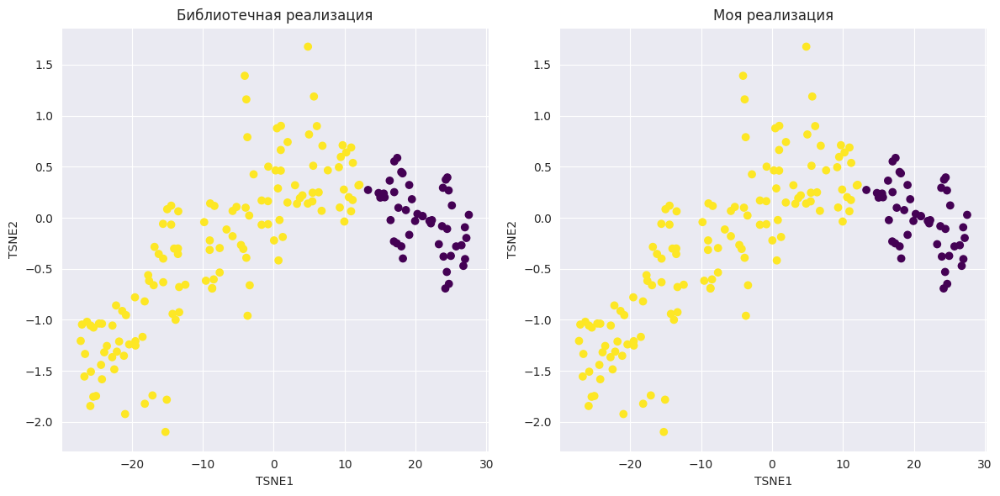

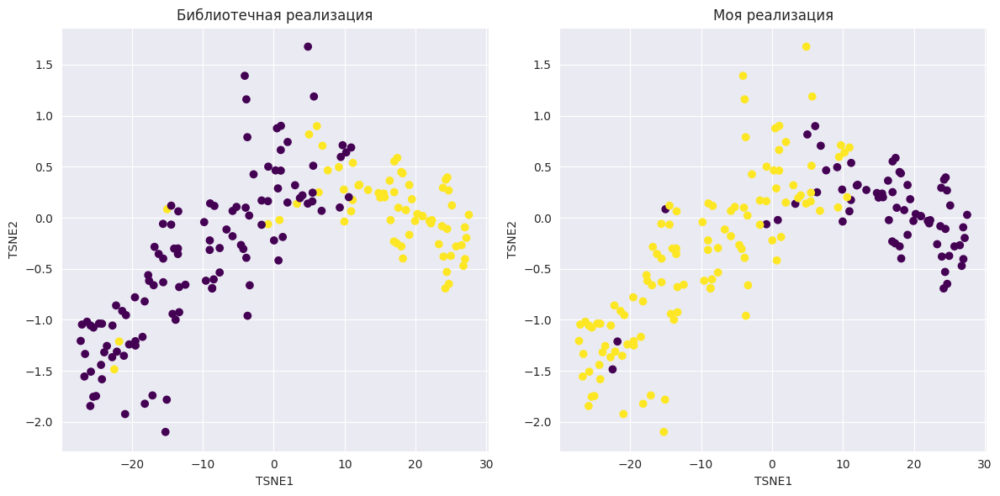

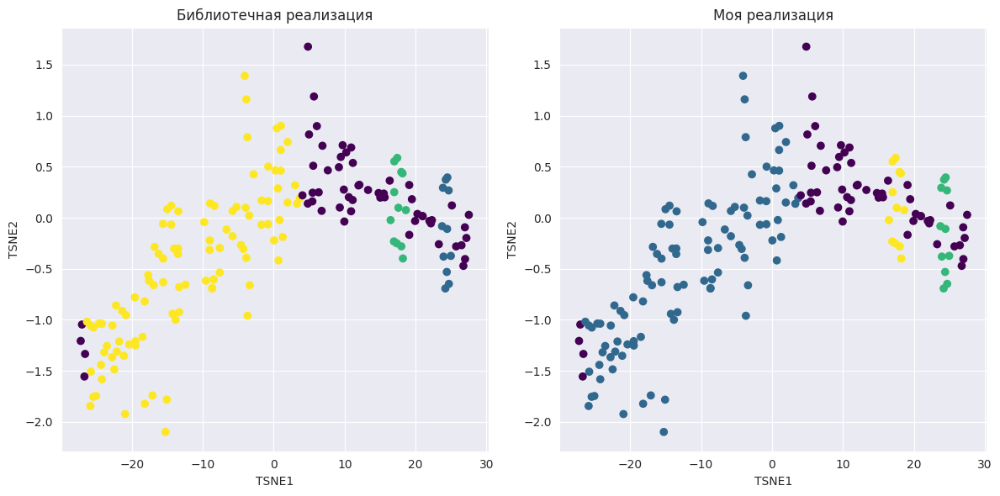

In [28]:
plot_tsne_comparison(X.to_numpy(), library_hierarchical_cluster_y, hierarchical_cluster_y)
plot_tsne_comparison(X.to_numpy(), em_cluster_y, library_em_cluster_y)
plot_tsne_comparison(X.to_numpy(), dbscan_cluster_y, library_dbscan_cluster_y)


In [29]:
def compute_stats(x: np.ndarray, cluster_labels: np.ndarray) -> dict:
    x_norm_matrix = np.linalg.norm(
        x[np.newaxis, :] - x[:, np.newaxis],
        axis=(2,)
    )
    average_inter_cluster_mask = (
            (cluster_labels[:, np.newaxis] == cluster_labels[np.newaxis, :])
            ^
            (np.arange(len(x))[:, np.newaxis] == np.arange(len(x))[np.newaxis, :])
    )
    average_inter_cluster_distances = np.sum(
        x_norm_matrix[average_inter_cluster_mask]
    ) / np.sum(average_inter_cluster_mask)

    average_intra_cluster_mask = cluster_labels[:, np.newaxis] != cluster_labels[np.newaxis, :]

    average_intra_cluster_distances = np.sum(
        x_norm_matrix[average_intra_cluster_mask]
    ) / np.sum(average_intra_cluster_mask)

    return {
        'average_inter_cluster_distances': average_inter_cluster_distances,
        'average_intra_cluster_distances': average_intra_cluster_distances,
    }


hierarchical_cluster_y_stats = compute_stats(X.to_numpy(), hierarchical_cluster_y)
library_hierarchical_cluster_y_stats = compute_stats(X.to_numpy(), library_hierarchical_cluster_y)
em_cluster_y_stats = compute_stats(X.to_numpy(), em_cluster_y)
library_em_cluster_y_stats = compute_stats(X.to_numpy(), library_em_cluster_y)
dbscan_cluster_y_stats = compute_stats(X.to_numpy(), dbscan_cluster_y)
library_dbscan_cluster_y_stats = compute_stats(X.to_numpy(), library_dbscan_cluster_y)


,Название,Среднее межкластерное расстояние (моя реализация),Среднее межкластерное расстояние (библиотечная реализация),Среднее внутрикластерное расстояние (моя реализация),Среднее внутрикластерное расстояние (библиотечная реализация),Время выполнения (моя реализация),Время выполнения (библиотечная реализация)
0,Иерархическая,185.808975,185.808975,606.969030,606.969030,1540000.0,219.0
1,EM-алгоритм,199.066453,199.066453,524.358062,524.358062,23300.0,337.0
2,DBSCAN,175.671615,175.671615,477.341627,477.341627,1090.0,2340.0


In [82]:
import pandas as pd

# Данные для моей реализации
df_own = pd.DataFrame({
    'Название': [
        'Иерархическая ',
        'EM-алгоритм',
        'DBSCAN',
    ],
    'Среднее межкластерное расстояние': [
        hierarchical_cluster_y_stats['average_inter_cluster_distances'],
        em_cluster_y_stats['average_inter_cluster_distances'],
        dbscan_cluster_y_stats['average_inter_cluster_distances'],
    ],
    'Среднее внутрикластерное расстояние': [
        hierarchical_cluster_y_stats['average_intra_cluster_distances'],
        em_cluster_y_stats['average_intra_cluster_distances'],
        dbscan_cluster_y_stats['average_intra_cluster_distances'],
    ],
    'Время выполнения': [
        1.54 * 1e6,
        23.3 * 1e3,
        1.09 * 1e3,
    ]
})

# Данные для библиотечной реализации
df_lib = pd.DataFrame({
    'Название': [
        'Иерархическая ',
        'EM-алгоритм',
        'DBSCAN',
    ],
    'Среднее межкластерное расстояние': [
        library_hierarchical_cluster_y_stats['average_inter_cluster_distances'],
        library_em_cluster_y_stats['average_inter_cluster_distances'],
        library_dbscan_cluster_y_stats['average_inter_cluster_distances'],
    ],
    'Среднее внутрикластерное расстояние': [
        library_hierarchical_cluster_y_stats['average_intra_cluster_distances'],
        library_em_cluster_y_stats['average_intra_cluster_distances'],
        library_dbscan_cluster_y_stats['average_intra_cluster_distances'],
    ],
    'Время выполнения': [
        219,
        337,
        2.34 * 1e3,
    ]
})

In [83]:
df_lib

,Название,Среднее межкластерное расстояние,Среднее внутрикластерное расстояние,Время выполнения
0,Иерархическая,185.808975,606.969030,219.0
1,EM-алгоритм,199.066453,524.358062,337.0
2,DBSCAN,175.671615,477.341627,2340.0


In [84]:
df_own

,Название,Среднее межкластерное расстояние,Среднее внутрикластерное расстояние,Время выполнения
0,Иерархическая,185.808975,606.969030,1540000.0
1,EM-алгоритм,199.066453,524.358062,23300.0
2,DBSCAN,175.671615,477.341627,1090.0


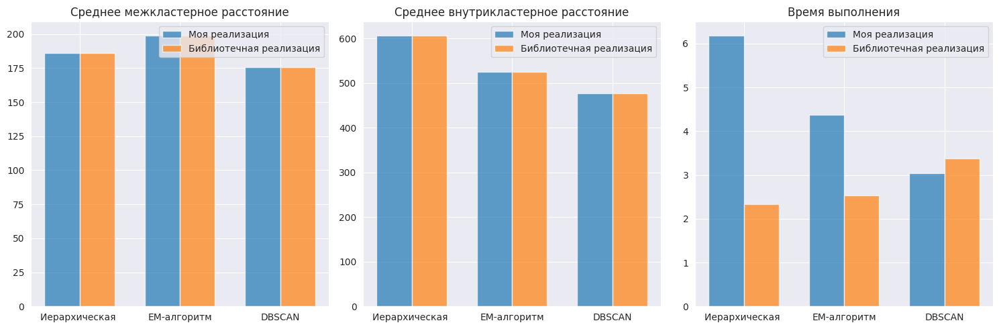

In [31]:
bar_width = 0.35
x = np.arange(len(df_own['Название']))  # Позиции для категорий

fig, axes = plt.subplots(1, 3, figsize=(15, 5))

axes[0].bar(x - bar_width / 2, df_own['Среднее межкластерное расстояние'],
            width=bar_width, label='Моя реализация', alpha=0.7)
axes[0].bar(x + bar_width / 2, df_lib['Среднее межкластерное расстояние'],
            width=bar_width, label='Библиотечная реализация', alpha=0.7)
axes[0].set_xticks(x)
axes[0].set_xticklabels(df_own['Название'])
axes[0].set_title('Среднее межкластерное расстояние')
axes[0].legend()

axes[1].bar(x - bar_width / 2, df_own['Среднее внутрикластерное расстояние'],
            width=bar_width, label='Моя реализация', alpha=0.7)
axes[1].bar(x + bar_width / 2, df_lib['Среднее внутрикластерное расстояние'],
            width=bar_width, label='Библиотечная реализация', alpha=0.7)
axes[1].set_xticks(x)
axes[1].set_xticklabels(df_own['Название'])
axes[1].set_title('Среднее внутрикластерное расстояние')
axes[1].legend()

axes[2].bar(x - bar_width / 2, np.log10(df_own['Время выполнения']),
            width=bar_width, label='Моя реализация', alpha=0.7)
axes[2].bar(x + bar_width / 2, np.log10(df_lib['Время выполнения']),
            width=bar_width, label='Библиотечная реализация', alpha=0.7)
axes[2].set_xticks(x)
axes[2].set_xticklabels(df_own['Название'])
axes[2].set_title('Время выполнения')
axes[2].legend()

plt.tight_layout()
plt.show()


In [32]:
from sklearn.datasets import make_blobs

blobs_X, labels_true = make_blobs(n_samples=750, centers=7, cluster_std=0.9, random_state=0)

In [33]:
from sklearn.manifold import TSNE


def plot_tsne_comparison(X: np.ndarray, cluster_y: np.ndarray, library_cluster_y: np.ndarray):
    tsne = TSNE(
        n_components=2,
        random_state=0,
        perplexity=20.0,
        metric='euclidean',
    )
    tsne_results = tsne.fit_transform(X)

    tsne_df = pd.DataFrame(tsne_results, columns=['TSNE1', 'TSNE2'])

    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 6))

    ax1.scatter(tsne_df['TSNE1'], tsne_df['TSNE2'], c=library_cluster_y, cmap='viridis')

    ax1.set_title('Библиотечная реализация')
    ax1.set_xlabel('TSNE1')
    ax1.set_ylabel('TSNE2')

    ax2.scatter(tsne_df['TSNE1'], tsne_df['TSNE2'], c=cluster_y, cmap='viridis')
    ax2.set_title('Моя реализация')
    ax2.set_xlabel('TSNE1')
    ax2.set_ylabel('TSNE2')

    # plt.legend(bbox_to_anchor=(1, 1), loc='upper left')
    plt.tight_layout()
    plt.show()

In [34]:
import kagglehub

path = kagglehub.dataset_download("himanshunakrani/iris-dataset")
iris_df = pd.read_csv(f'{path}/iris.csv')

iris_df

,sepal_length,sepal_width,petal_length,petal_width,species
0,5.1,3.5,1.4,0.2,setosa
1,4.9,3.0,1.4,0.2,setosa
2,4.7,3.2,1.3,0.2,setosa
3,4.6,3.1,1.5,0.2,setosa
4,5.0,3.6,1.4,0.2,setosa
...,...,...,...,...,...
145,6.7,3.0,5.2,2.3,virginica
146,6.3,2.5,5.0,1.9,virginica
147,6.5,3.0,5.2,2.0,virginica
148,6.2,3.4,5.4,2.3,virginica


In [35]:
iris_X = iris_df.iloc[:, :-1]
iris_y = iris_df.iloc[:, -1]

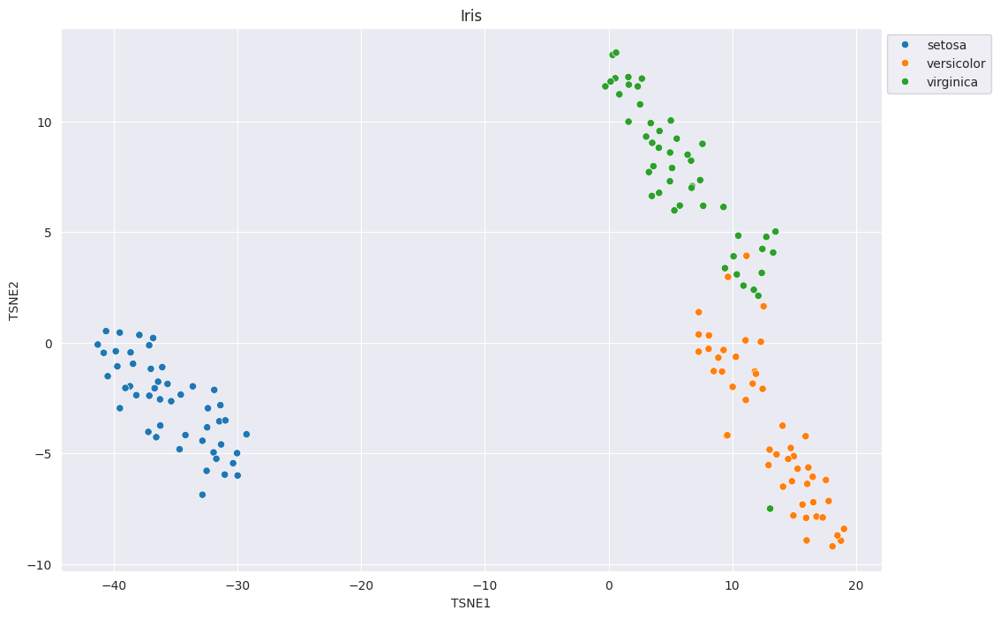

In [69]:
tsne_iris_X = iris_X.apply(pd.to_numeric, errors='coerce')

tsne_iris_X = tsne_iris_X.dropna()

tsne = TSNE(
    n_components=2,
    random_state=0,
    perplexity=20.0,
    metric='euclidean',
)
tsne_results = tsne.fit_transform(tsne_iris_X)

tsne_df = pd.DataFrame(tsne_results, columns=['TSNE1', 'TSNE2'])
tsne_df['species'] = iris_df['species']

plt.figure(figsize=(12, 8))
sns.scatterplot(x='TSNE1', y='TSNE2',
                hue='species',
                data=tsne_df,
                palette='tab10'
                )
plt.title('Iris')
plt.xlabel('TSNE1')
plt.ylabel('TSNE2')
plt.legend(bbox_to_anchor=(1, 1), loc='upper left')
plt.show()

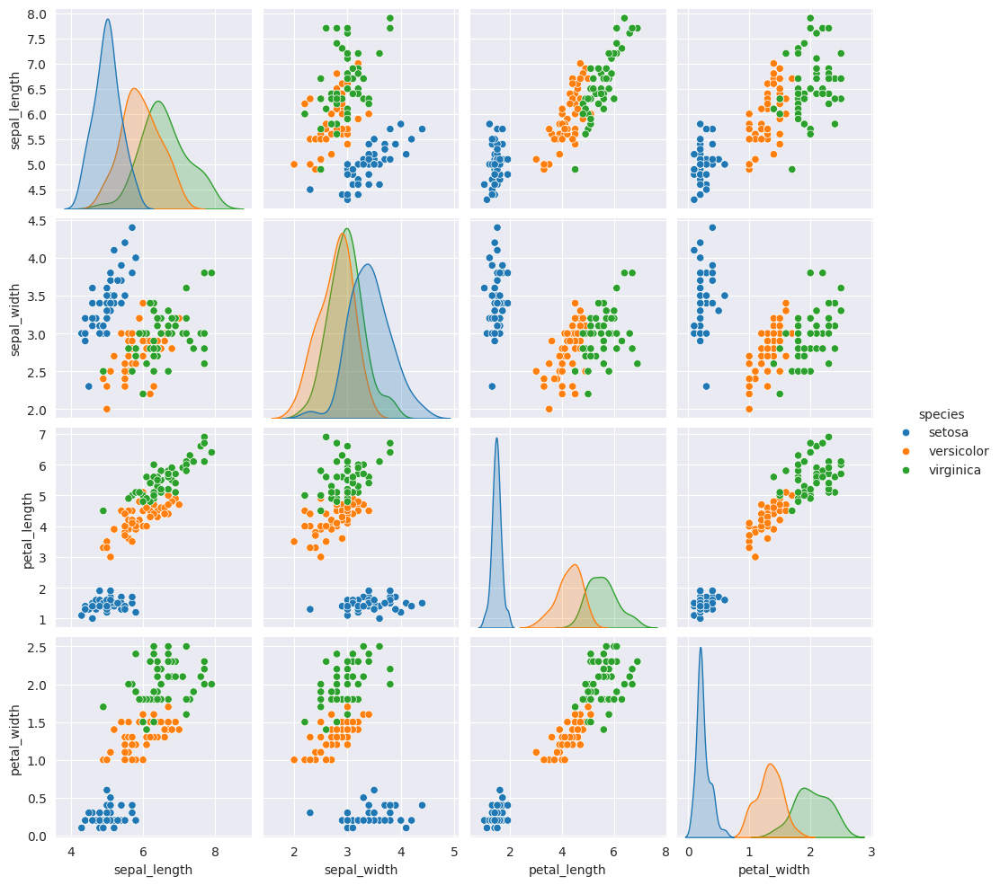

In [36]:
sns.pairplot(
    pd.concat((iris_X, iris_y), axis=1),
    hue='species',
)

In [53]:
distances = pairwise_distance(iris_X.to_numpy())
link_table = link(
    distances_matrix=distances,
)

link_table = np.array(link_table, dtype=np.float64)

threshold_cluster = find_threshold_cluster(link_table)
iris_cluster_count = len(iris_X) - threshold_cluster - 1
hierarchical_cluster_y = allocate_clusters(iris_X, link_table, threshold_cluster)
hierarchical_cluster_y


array([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1])

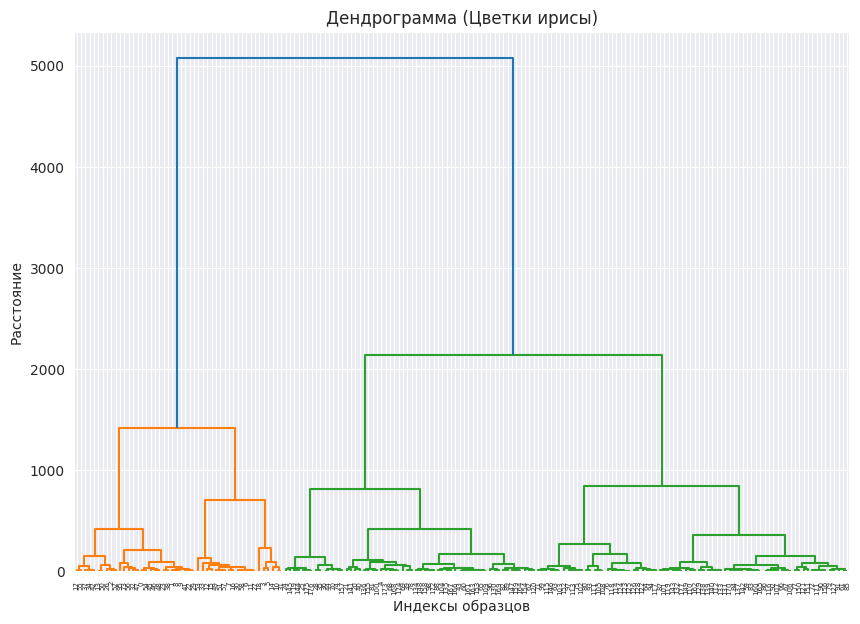

In [80]:
plt.figure(figsize=(10, 7))
dendrogram(link_table)
plt.title('Дендрограмма (Цветки ирисы)')
plt.xlabel('Индексы образцов')
plt.ylabel('Расстояние')
plt.show()

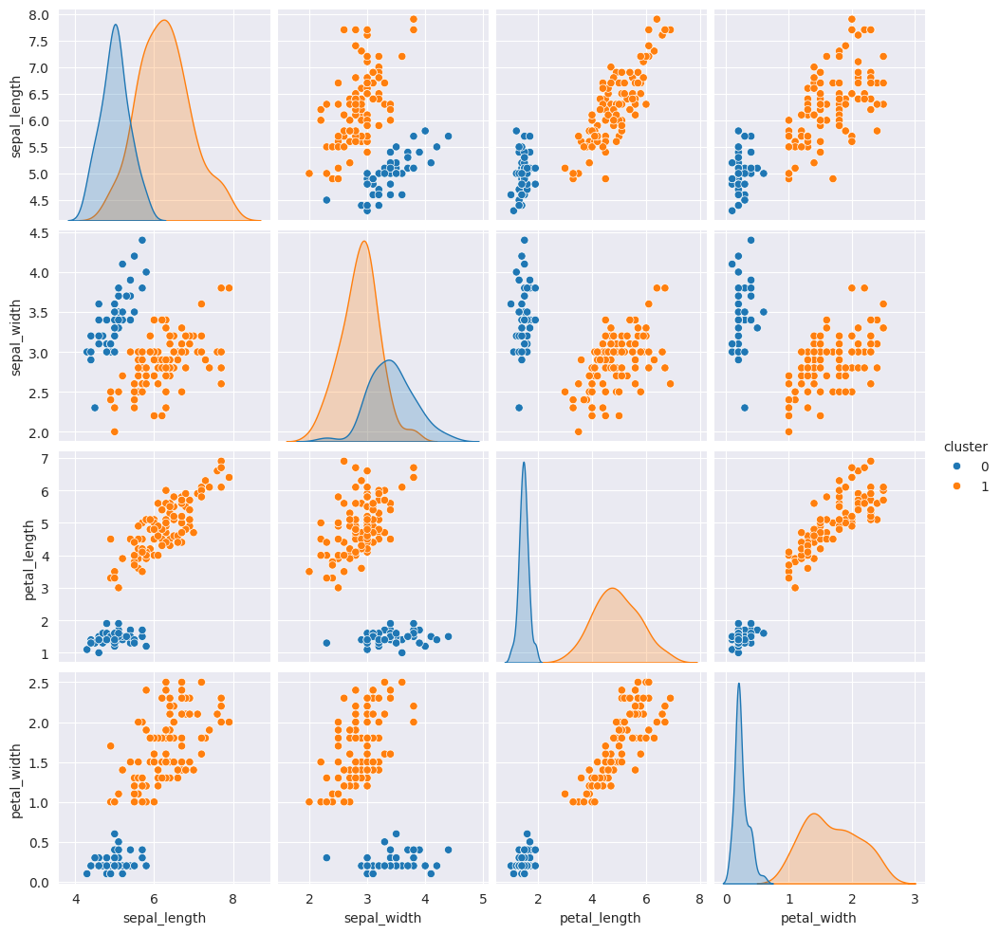

In [38]:
sns.pairplot(
    pd.concat((iris_X, pd.DataFrame(hierarchical_cluster_y, columns=['cluster'])), axis=1),
    hue='cluster',
)

In [54]:
iris_cluster_count

np.int64(2)

In [40]:
em_cluster_y = em_gmm(iris_X.to_numpy(), cluster_count=iris_cluster_count, )

em_cluster_y

array([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1])

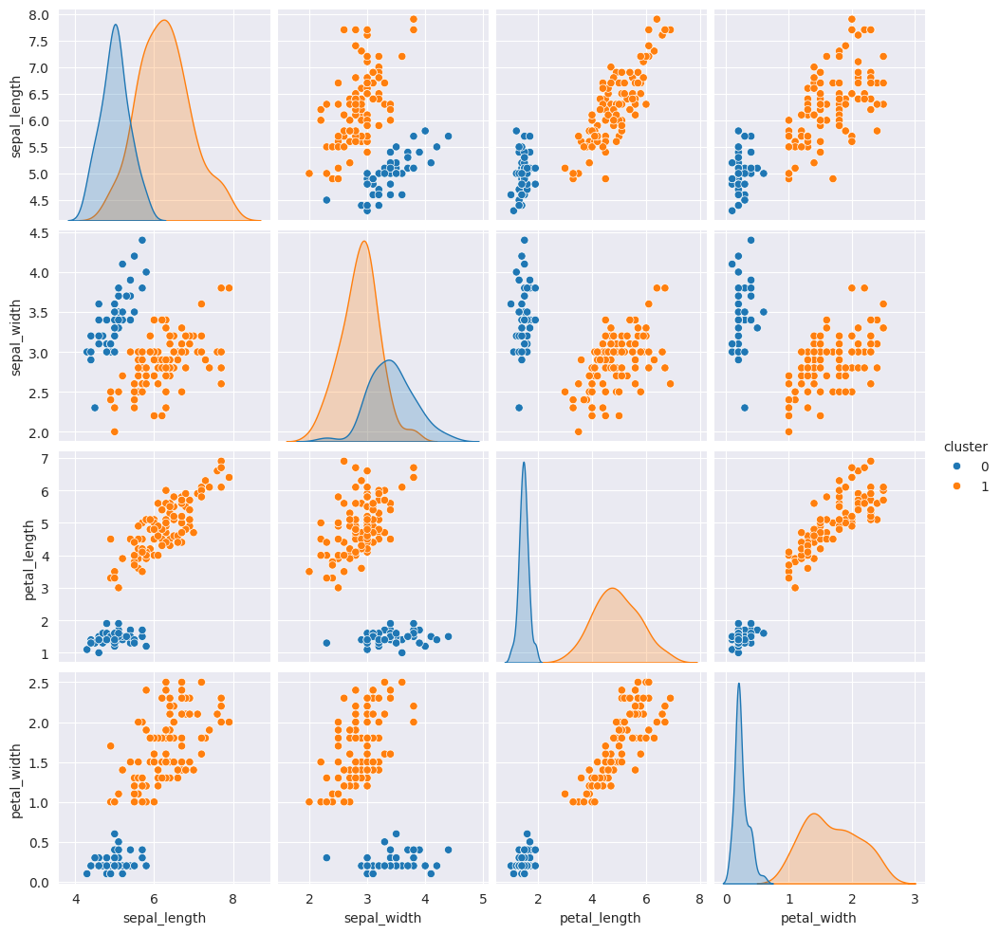

In [41]:
sns.pairplot(
    pd.concat((iris_X, pd.DataFrame(em_cluster_y, columns=['cluster'])), axis=1),
    hue='cluster',
)

In [42]:
dbscan_cluster_y = cluster_by_dbscan(iris_X.to_numpy(), m=3, e=0.9)
dbscan_cluster_y

array([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], dtype=int8)

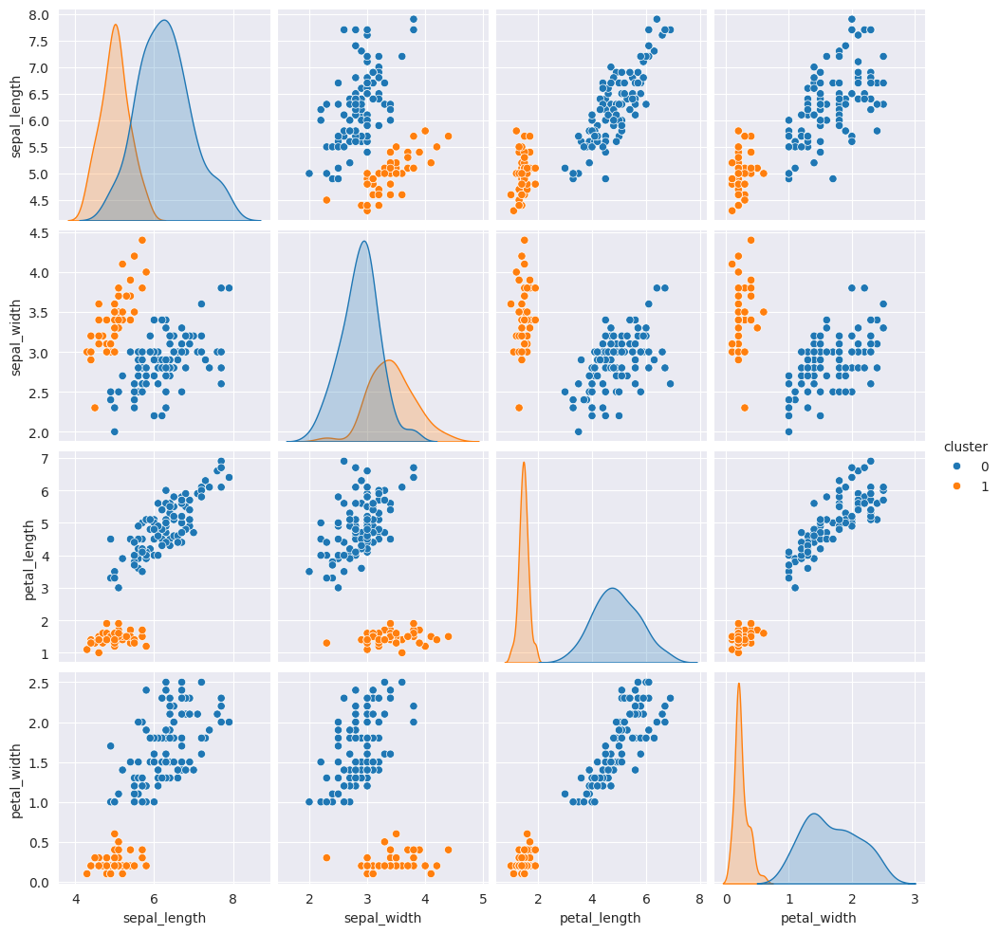

In [43]:
sns.pairplot(
    pd.concat((iris_X, pd.DataFrame(dbscan_cluster_y, columns=['cluster'])), axis=1),
    hue='cluster',
)

In [ ]:
allocate_clusters(iris_X, link_table, threshold_cluster)

In [61]:
iris_hierarchical_cluster_y = allocate_clusters(iris_X, link(pairwise_distance(iris_X.to_numpy())), threshold_cluster)
iris_library_hierarchical_cluster_y = allocate_clusters(iris_X, linkage(pdist(iris_X), method="ward"), threshold_cluster)
iris_em_cluster_y = em_gmm(iris_X.to_numpy(), cluster_count=iris_cluster_count, )
iris_library_em_cluster_y = GaussianMixture(n_components=iris_cluster_count, random_state=0, max_iter=100, covariance_type='diag').fit(iris_X).predict(iris_X)
iris_dbscan_cluster_y = cluster_by_dbscan(iris_X.to_numpy(), m=3, e=0.9)
iris_library_dbscan_cluster_y = DBSCAN(eps=0.9, min_samples=3).fit(iris_X).labels_

In [62]:
iris_hierarchical_cluster_y_stats = compute_stats(iris_X.to_numpy(), iris_hierarchical_cluster_y)
iris_library_hierarchical_cluster_y_stats = compute_stats(iris_X.to_numpy(), iris_library_hierarchical_cluster_y)
iris_em_cluster_y_stats = compute_stats(iris_X.to_numpy(), iris_em_cluster_y)
iris_library_em_cluster_y_stats = compute_stats(iris_X.to_numpy(), iris_library_em_cluster_y)
iris_dbscan_cluster_y_stats = compute_stats(iris_X.to_numpy(), iris_dbscan_cluster_y)
iris_library_dbscan_cluster_y_stats = compute_stats(iris_X.to_numpy(), iris_library_dbscan_cluster_y)

In [63]:
gmm = GaussianMixture(n_components=2, random_state=0, max_iter=100, covariance_type='diag')
gmm.fit(iris_X)
print("Библиотечная реализация EM-алгоритма")
%timeit gmm.predict(iris_X)
print("Ручная реализация EM-алгоритма")
%timeit em_gmm(iris_X.to_numpy(), cluster_count=2, )
library_distance_matrix = pdist(iris_X.to_numpy(), metric='euclidean')
distance_matrix = pairwise_distance(iris_X.to_numpy())
print("Библиотечная реализация иерархической кластеризации")
%timeit linkage(library_distance_matrix, method="ward")
print("Ручная реализация иерархической кластеризации")
%timeit link(distances_matrix=distance_matrix)
print("Библиотечная реализация DBSCAN алгоритма")
%timeit DBSCAN(eps=30, min_samples=10).fit(iris_X)
print("Ручная реализация DBSCAN алгоритма")
%timeit cluster_by_dbscan(iris_X.to_numpy(), m=3, e=0.9)

Библиотечная реализация EM-алгоритма
302 μs ± 29.5 μs per loop (mean ± std. dev. of 7 runs, 1,000 loops each)
Ручная реализация EM-алгоритма
4.04 ms ± 703 μs per loop (mean ± std. dev. of 7 runs, 100 loops each)
Библиотечная реализация иерархической кластеризации
129 μs ± 1.46 μs per loop (mean ± std. dev. of 7 runs, 10,000 loops each)
Ручная реализация иерархической кластеризации
206 ms ± 7.03 ms per loop (mean ± std. dev. of 7 runs, 10 loops each)
Библиотечная реализация DBSCAN алгоритма
793 μs ± 8.1 μs per loop (mean ± std. dev. of 7 runs, 1,000 loops each)
Ручная реализация DBSCAN алгоритма
2.02 ms ± 11.1 μs per loop (mean ± std. dev. of 7 runs, 100 loops each)


In [75]:
import pandas as pd

# Данные для моей реализации
df_own = pd.DataFrame({
    'Название': [
        'Иерархическая ',
        'EM-алгоритм',
        'DBSCAN',
    ],
    'Среднее межкластерное расстояние': [
        iris_hierarchical_cluster_y_stats['average_inter_cluster_distances'],
        iris_em_cluster_y_stats['average_inter_cluster_distances'],
        iris_dbscan_cluster_y_stats['average_inter_cluster_distances'],
    ],
    'Среднее внутрикластерное расстояние': [
        iris_hierarchical_cluster_y_stats['average_intra_cluster_distances'],
        iris_em_cluster_y_stats['average_intra_cluster_distances'],
        iris_dbscan_cluster_y_stats['average_intra_cluster_distances'],
    ],
    'Время выполнения': [
        211 * 1e3,
        3.49 * 1e3,
        2.05 * 1e3,
    ]
})

# Данные для библиотечной реализации
df_lib = pd.DataFrame({
    'Название': [
        'Иерархическая ',
        'EM-алгоритм',
        'DBSCAN',
    ],
    'Среднее межкластерное расстояние': [
        iris_library_hierarchical_cluster_y_stats['average_inter_cluster_distances'],
        iris_library_em_cluster_y_stats['average_inter_cluster_distances'],
        iris_library_dbscan_cluster_y_stats['average_inter_cluster_distances'],
    ],
    'Среднее внутрикластерное расстояние': [
        iris_library_hierarchical_cluster_y_stats['average_intra_cluster_distances'],
        iris_library_em_cluster_y_stats['average_intra_cluster_distances'],
        iris_library_dbscan_cluster_y_stats['average_intra_cluster_distances'],
    ],
    'Время выполнения': [
        131,
        278,
        827,
    ]
})


In [74]:
df_lib

,Название,Среднее межкластерное расстояние,Среднее внутрикластерное расстояние,Время выполнения
0,Иерархическая,1.315717,4.060413,131
1,EM-алгоритм,1.315717,4.060413,278
2,DBSCAN,1.315717,4.060413,827


In [73]:
df_own

,Название,Среднее межкластерное расстояние,Среднее внутрикластерное расстояние,Время выполнения
0,Иерархическая,1.315717,4.060413,211000.0
1,EM-алгоритм,1.315717,4.060413,3490.0
2,DBSCAN,1.315717,4.060413,2050.0


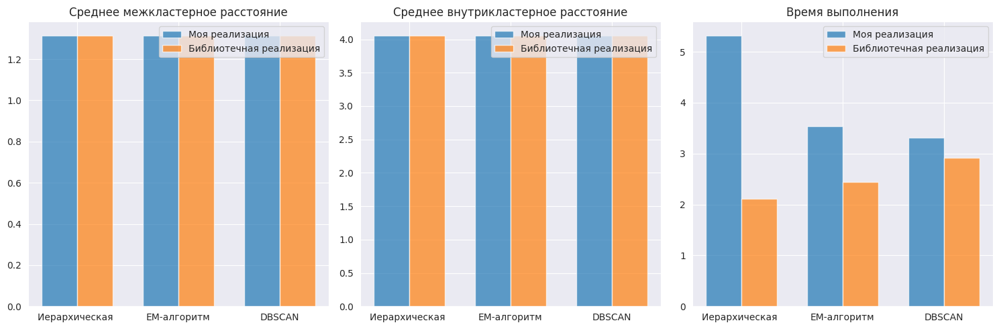

In [66]:
bar_width = 0.35
x = np.arange(len(df_own['Название']))  # Позиции для категорий

fig, axes = plt.subplots(1, 3, figsize=(15, 5))

axes[0].bar(x - bar_width / 2, df_own['Среднее межкластерное расстояние'],
            width=bar_width, label='Моя реализация', alpha=0.7)
axes[0].bar(x + bar_width / 2, df_lib['Среднее межкластерное расстояние'],
            width=bar_width, label='Библиотечная реализация', alpha=0.7)
axes[0].set_xticks(x)
axes[0].set_xticklabels(df_own['Название'])
axes[0].set_title('Среднее межкластерное расстояние')
axes[0].legend()

axes[1].bar(x - bar_width / 2, df_own['Среднее внутрикластерное расстояние'],
            width=bar_width, label='Моя реализация', alpha=0.7)
axes[1].bar(x + bar_width / 2, df_lib['Среднее внутрикластерное расстояние'],
            width=bar_width, label='Библиотечная реализация', alpha=0.7)
axes[1].set_xticks(x)
axes[1].set_xticklabels(df_own['Название'])
axes[1].set_title('Среднее внутрикластерное расстояние')
axes[1].legend()

axes[2].bar(x - bar_width / 2, np.log10(df_own['Время выполнения']),
            width=bar_width, label='Моя реализация', alpha=0.7)
axes[2].bar(x + bar_width / 2, np.log10(df_lib['Время выполнения']),
            width=bar_width, label='Библиотечная реализация', alpha=0.7)
axes[2].set_xticks(x)
axes[2].set_xticklabels(df_own['Название'])
axes[2].set_title('Время выполнения')
axes[2].legend()

plt.tight_layout()
plt.show()